In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

In [2]:
df = pd.read_pickle("../../data/interim/01_data_processed.pkl")

In [3]:
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,90
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,90
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,90


In [4]:
set_df = df[df["set"] == 1]

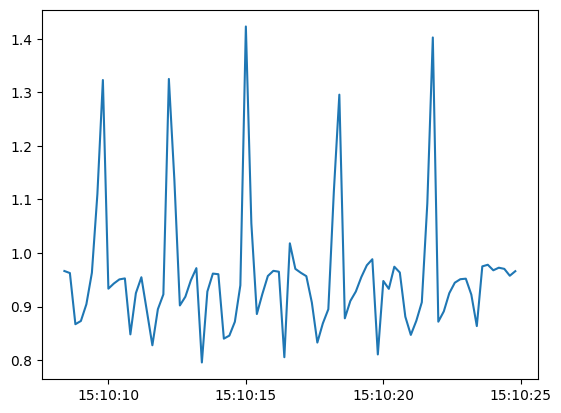

In [5]:
plt.plot(set_df["acc_y"])  # has time as x axis

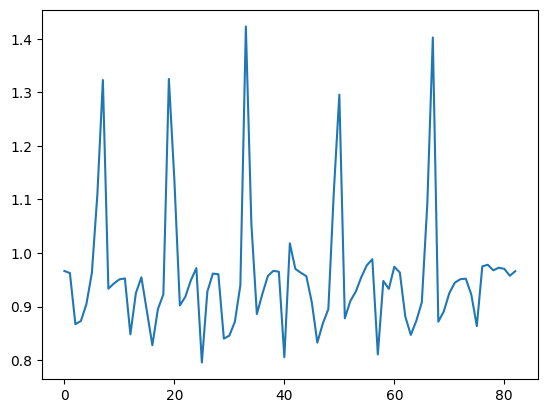

In [6]:
plt.plot(set_df["acc_y"].reset_index(drop=True))  # has no of samples as x axis

In [7]:
set_df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:10:08.400,0.003667,0.966333,-0.081000,1.8412,-4.7806,-2.5608,A,bench,heavy,1
2019-01-11 15:10:08.600,-0.012500,0.962500,-0.089000,2.1950,-2.1096,-2.8538,A,bench,heavy,1
2019-01-11 15:10:08.800,-0.028000,0.867000,-0.125000,9.5246,-2.8290,-11.1828,A,bench,heavy,1
2019-01-11 15:10:09.000,-0.062000,0.873000,-0.155000,16.5608,-4.4268,-13.0368,A,bench,heavy,1
2019-01-11 15:10:09.200,-0.096667,0.904333,-0.169000,7.6952,-11.8538,-3.0364,A,bench,heavy,1
...,...,...,...,...,...,...,...,...,...,...
2019-01-11 15:10:24.000,0.038667,0.967667,-0.100000,-0.2194,-4.9756,-3.8658,A,bench,heavy,1
2019-01-11 15:10:24.200,0.018500,0.972500,-0.083000,0.7924,-1.8536,0.6220,A,bench,heavy,1
2019-01-11 15:10:24.400,0.019667,0.970333,-0.079667,-1.9270,0.5852,-2.0246,A,bench,heavy,1


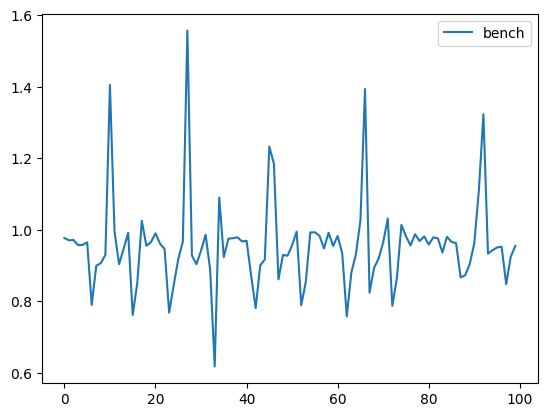

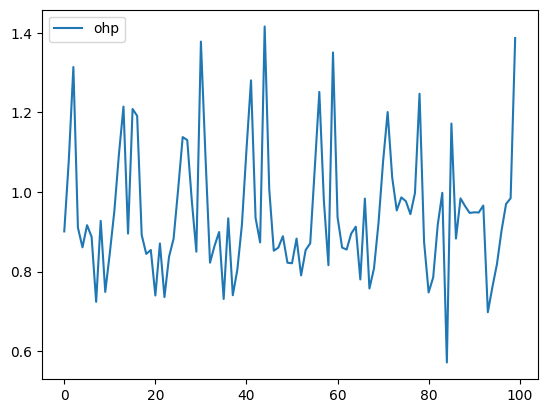

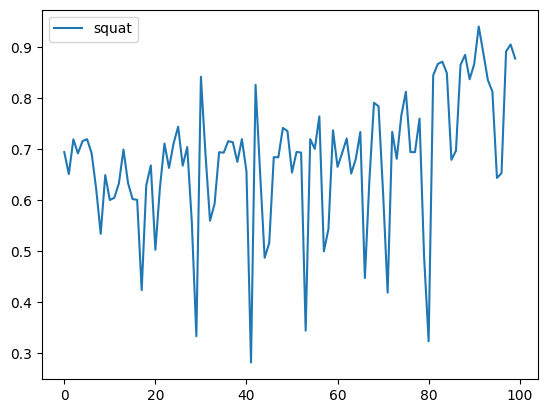

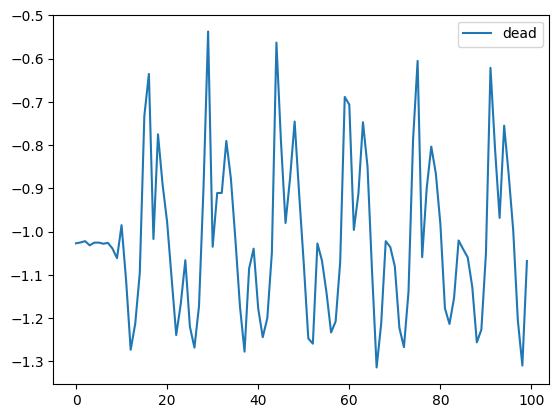

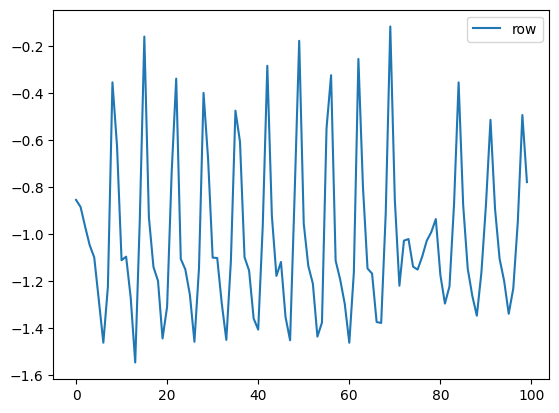

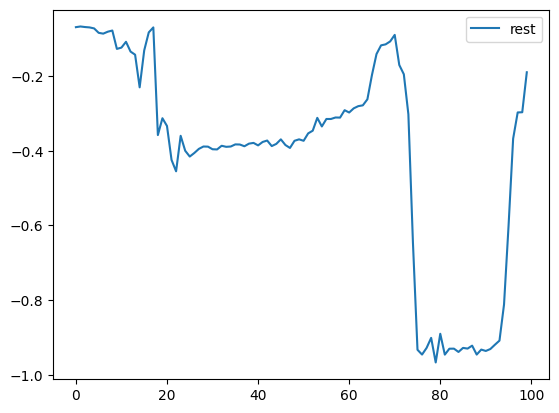

In [8]:
for label in df["label"].unique():
    subset = df[df["label"] == label]
    fig, ax = plt.subplots()
    plt.plot(subset[:100]["acc_y"].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

In [9]:
mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"] = (20, 5)
mpl.rcParams["figure.dpi"] = 100

In [10]:
category_df = df.query("label=='squat'").query("participant ==' A'").reset_index()

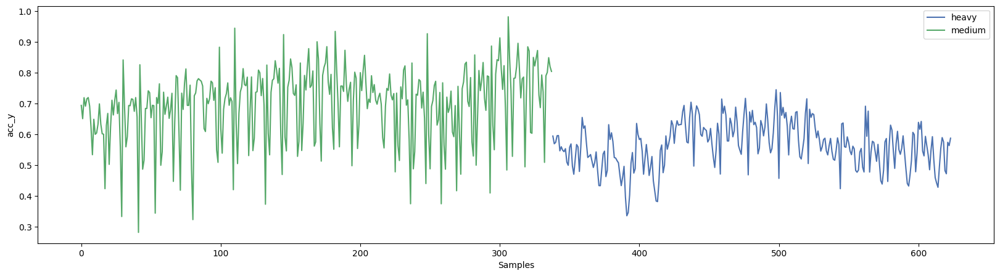

In [11]:
fig, ax = plt.subplots()
category_df.groupby(["category"])["acc_y"].plot()
ax.set_xlabel("Samples")
ax.set_ylabel("acc_y")
plt.legend()
plt.show()

In [12]:
category_df

,epoch (ms),acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
0,2019-01-11 16:05:44.600,0.135333,0.694667,0.735333,2.5366,-0.6220,1.6098,A,squat,medium,27
1,2019-01-11 16:05:44.800,0.097500,0.651500,0.658000,2.0854,0.0366,0.1952,A,squat,medium,27
2,2019-01-11 16:05:45.000,0.148667,0.719667,0.694333,-0.0364,1.2562,0.0242,A,squat,medium,27
3,2019-01-11 16:05:45.200,0.138000,0.692000,0.632000,5.9878,-4.5734,1.0976,A,squat,medium,27
4,2019-01-11 16:05:45.400,0.131667,0.716000,0.658000,-4.1586,-2.9636,-0.5852,A,squat,medium,27
...,...,...,...,...,...,...,...,...,...,...,...
619,2019-01-15 19:14:22.600,0.022333,0.482667,0.656000,-8.0976,5.9026,2.9512,A,squat,heavy,26
620,2019-01-15 19:14:22.800,0.028500,0.472500,0.657500,-5.4024,1.6340,3.1584,A,squat,heavy,26
621,2019-01-15 19:14:23.000,0.012000,0.574667,0.839667,6.3904,-1.0854,2.0856,A,squat,heavy,26
622,2019-01-15 19:14:23.200,0.010500,0.564000,0.785000,5.0246,-1.2196,1.8900,A,squat,heavy,26


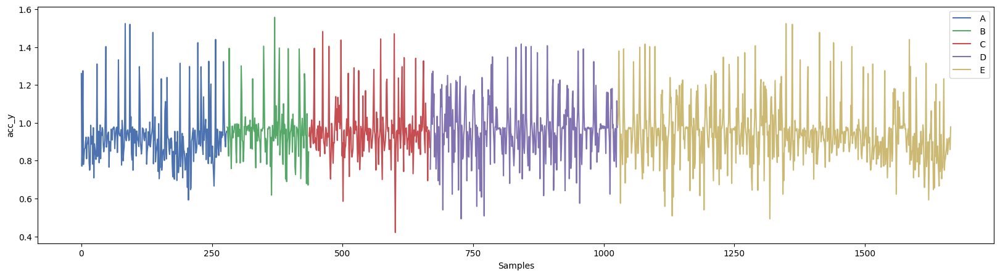

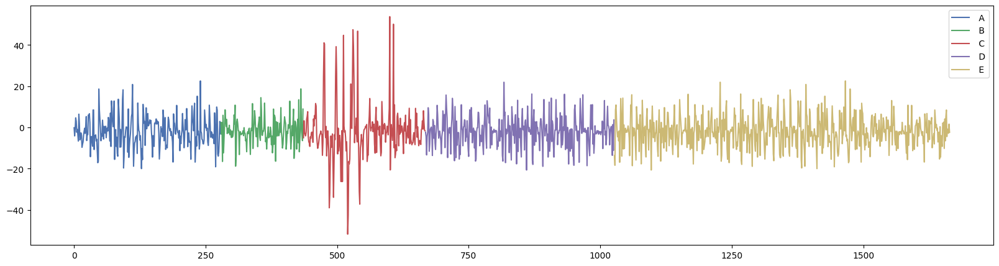

In [14]:
participant_df = df.query("label=='bench'").sort_values("participant").reset_index()
participant_df["participant"].unique()

fig, ax = plt.subplots()
participant_df.groupby(["participant"])["acc_y"].plot()
ax.set_xlabel("Samples")
ax.set_ylabel("acc_y")
plt.legend()
plt.show()

participant_df.groupby(["participant"])["gyr_y"].plot()
ax.set_xlabel("Samples")
ax.set_ylabel("gyr_y")
plt.legend()
plt.show()

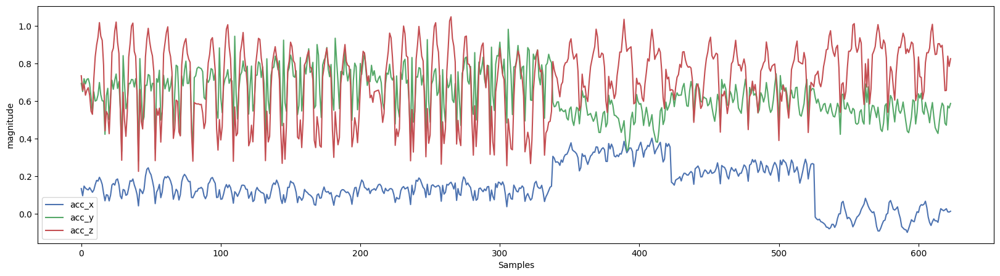

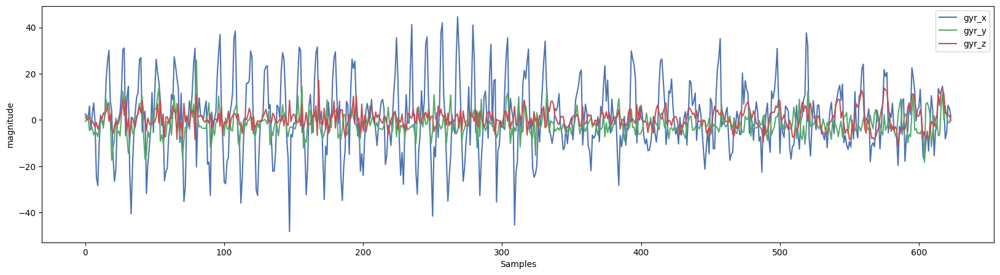

In [15]:
label = "squat"
participant = " A"
all_axis_df = (
    df.query(f"label == '{label}'").query(f"participant=='{participant}'").reset_index()
)

fig, ax = plt.subplots()
all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
ax.set_xlabel("Samples")
ax.set_ylabel("magnitude")
plt.legend()
plt.show()

fig, ax = plt.subplots()
all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax)
ax.set_xlabel("Samples")
ax.set_ylabel("magnitude")
plt.legend()
plt.show()

In [17]:
all_axis_df

,epoch (ms),acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
0,2019-01-11 16:05:44.600,0.135333,0.694667,0.735333,2.5366,-0.6220,1.6098,A,squat,medium,27
1,2019-01-11 16:05:44.800,0.097500,0.651500,0.658000,2.0854,0.0366,0.1952,A,squat,medium,27
2,2019-01-11 16:05:45.000,0.148667,0.719667,0.694333,-0.0364,1.2562,0.0242,A,squat,medium,27
3,2019-01-11 16:05:45.200,0.138000,0.692000,0.632000,5.9878,-4.5734,1.0976,A,squat,medium,27
4,2019-01-11 16:05:45.400,0.131667,0.716000,0.658000,-4.1586,-2.9636,-0.5852,A,squat,medium,27
...,...,...,...,...,...,...,...,...,...,...,...
619,2019-01-15 19:14:22.600,0.022333,0.482667,0.656000,-8.0976,5.9026,2.9512,A,squat,heavy,26
620,2019-01-15 19:14:22.800,0.028500,0.472500,0.657500,-5.4024,1.6340,3.1584,A,squat,heavy,26
621,2019-01-15 19:14:23.000,0.012000,0.574667,0.839667,6.3904,-1.0854,2.0856,A,squat,heavy,26
622,2019-01-15 19:14:23.200,0.010500,0.564000,0.785000,5.0246,-1.2196,1.8900,A,squat,heavy,26


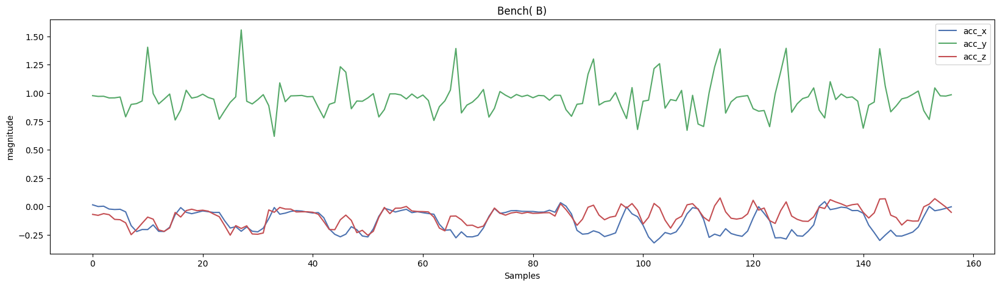

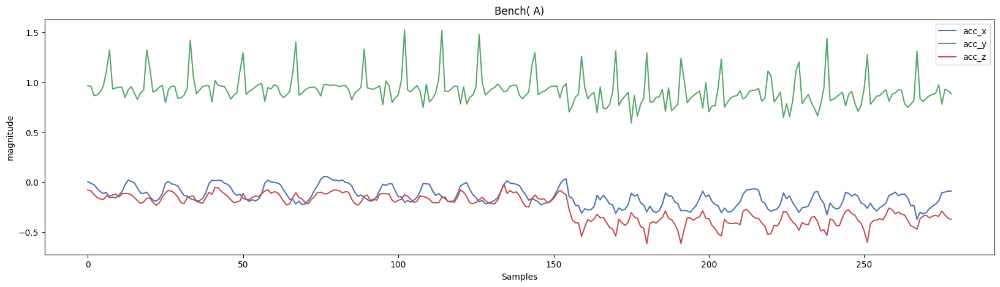

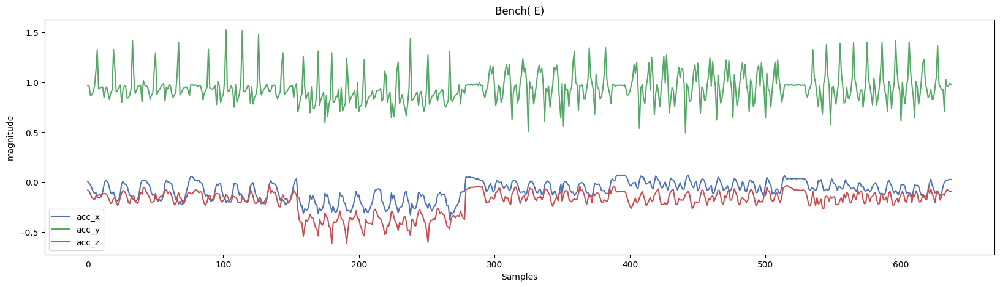

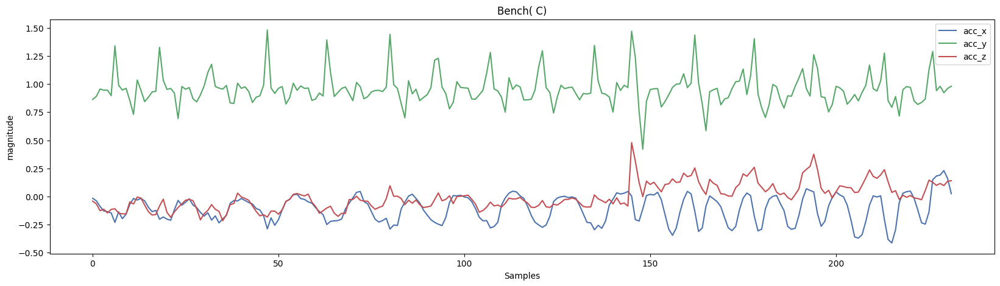

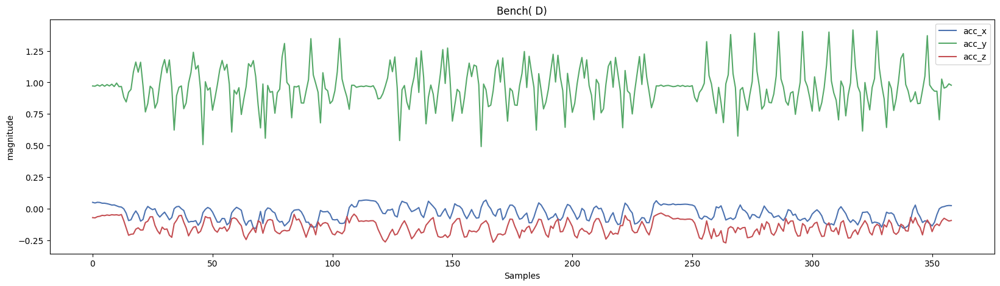

...

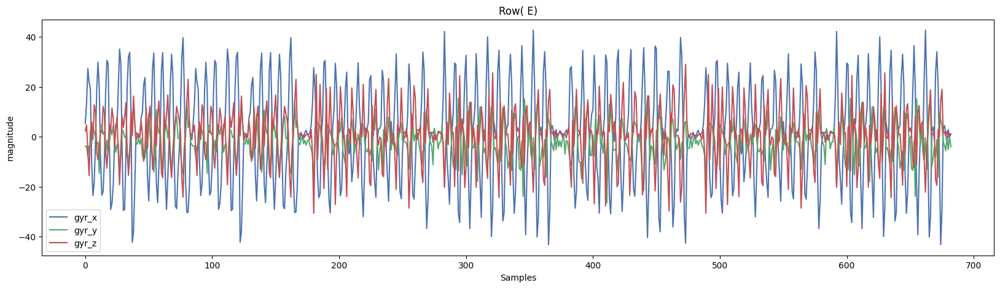

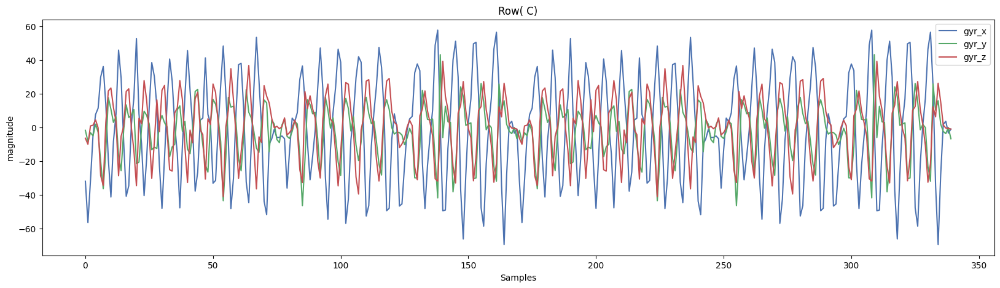

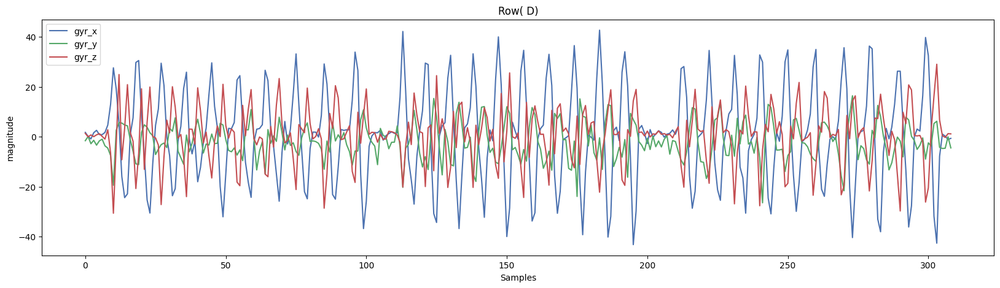

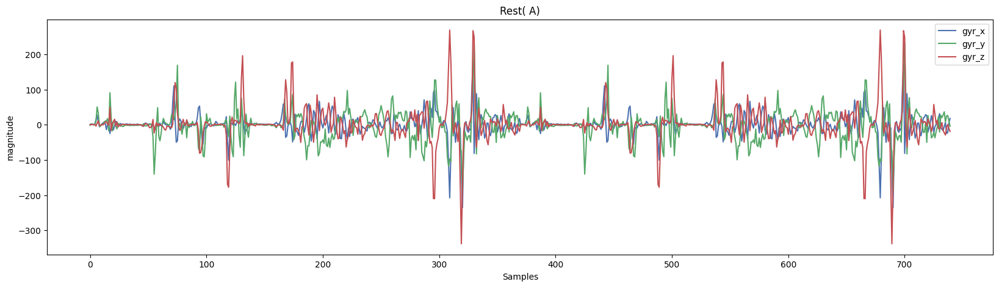

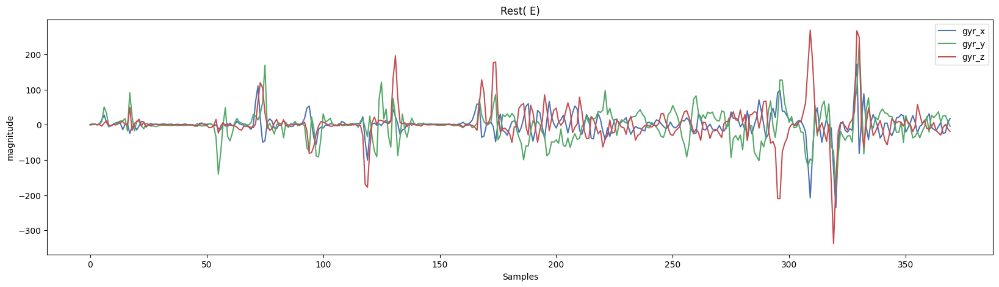

In [18]:
labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )

        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
            ax.set_xlabel("Samples")
            ax.set_ylabel("magnitude")
            plt.title(f"{label}({participant})".title())
            plt.legend()
            plt.show()


for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )

        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax)
            ax.set_xlabel("Samples")
            ax.set_ylabel("magnitude")
            plt.title(f"{label}({participant})".title())
            plt.legend()
            plt.show()

Text(0.5, 0, 'Samples')

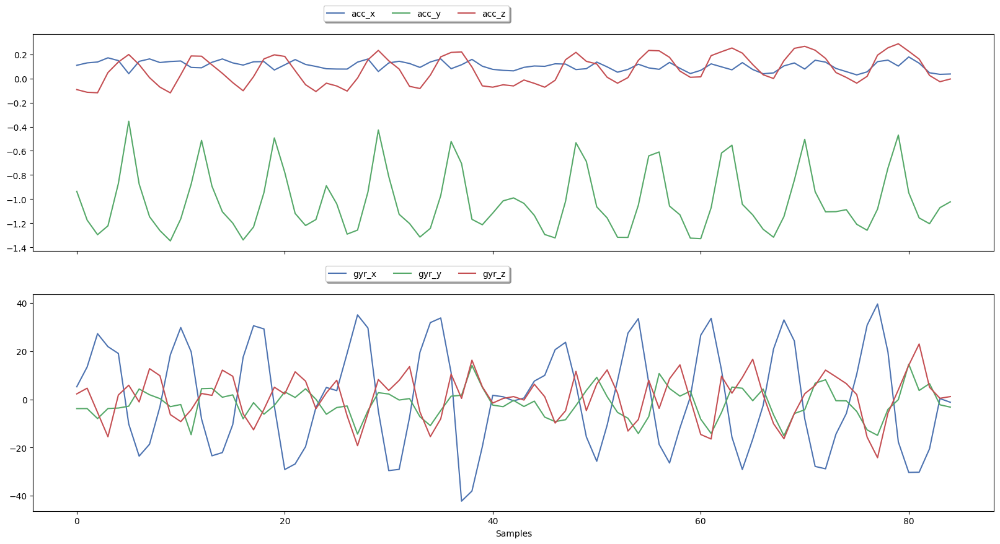

In [19]:
label = "row"
participant = " A"
combined_plot_df = (
    df.query(f"label == '{label}'").query(f"participant=='{participant}'").reset_index()
)

fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

ax[0].legend(
    loc="upper right", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
)
ax[1].legend(
    loc="upper right", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
)
ax[1].set_xlabel("Samples")

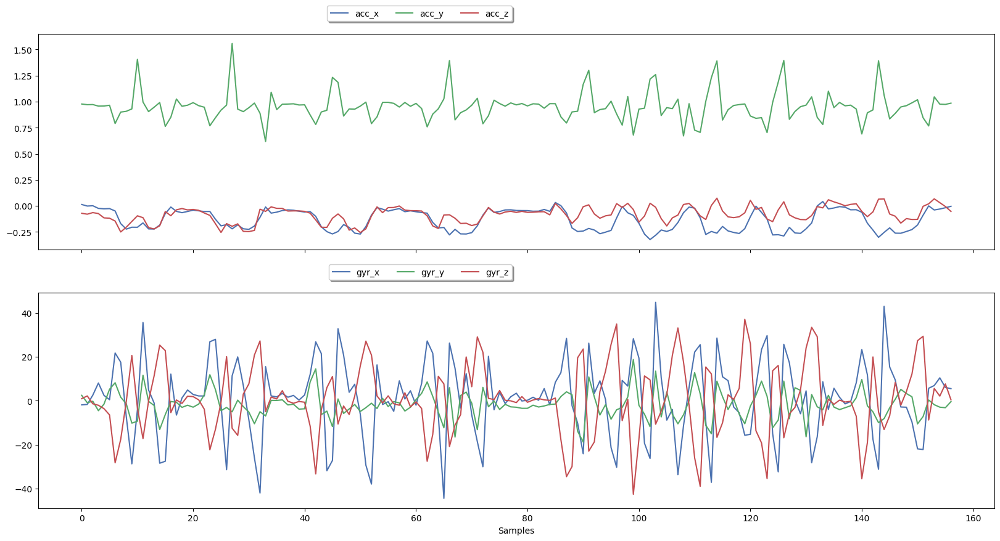

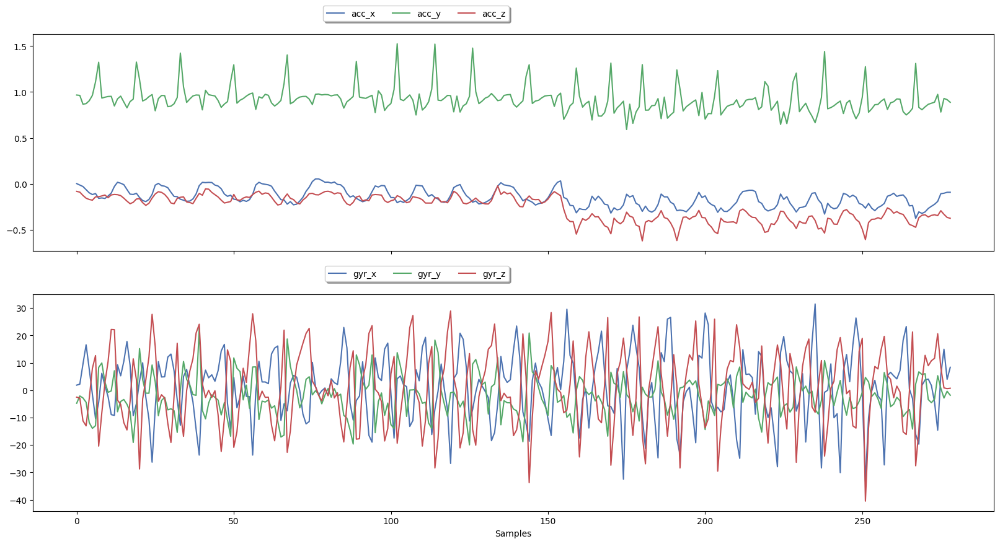

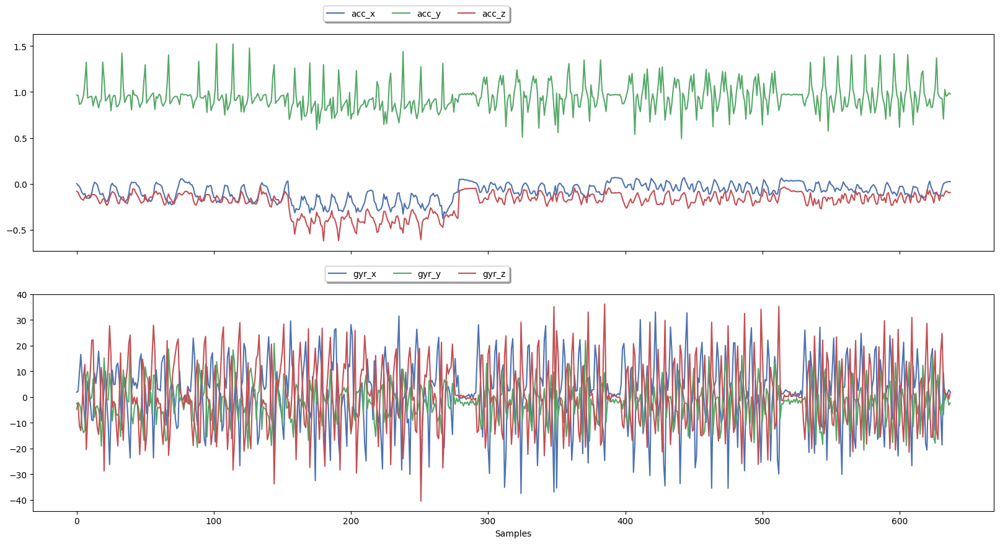

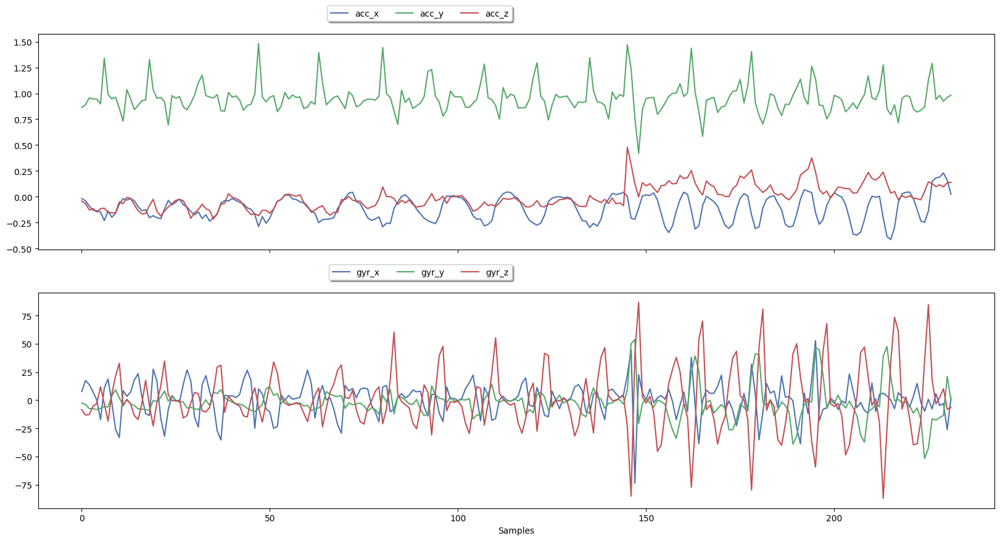

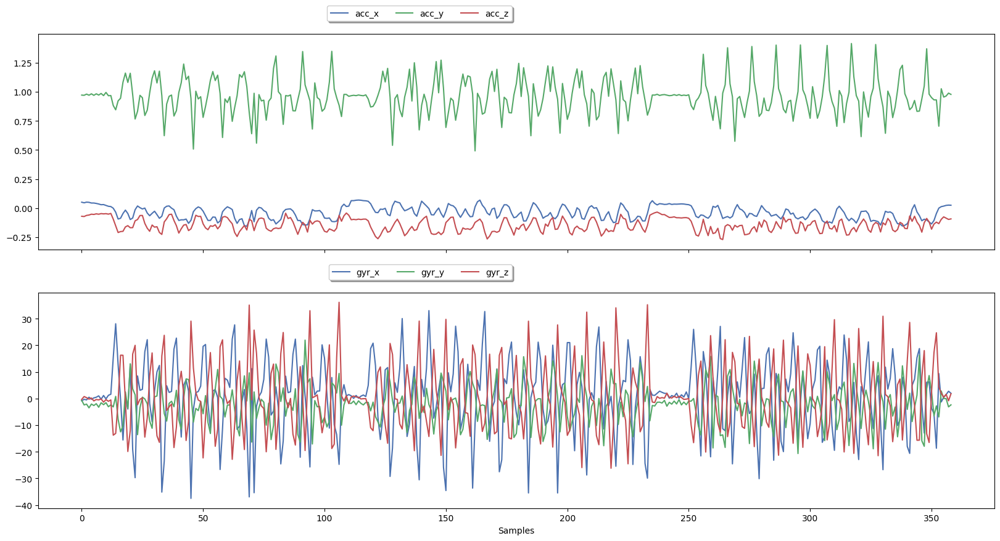

...

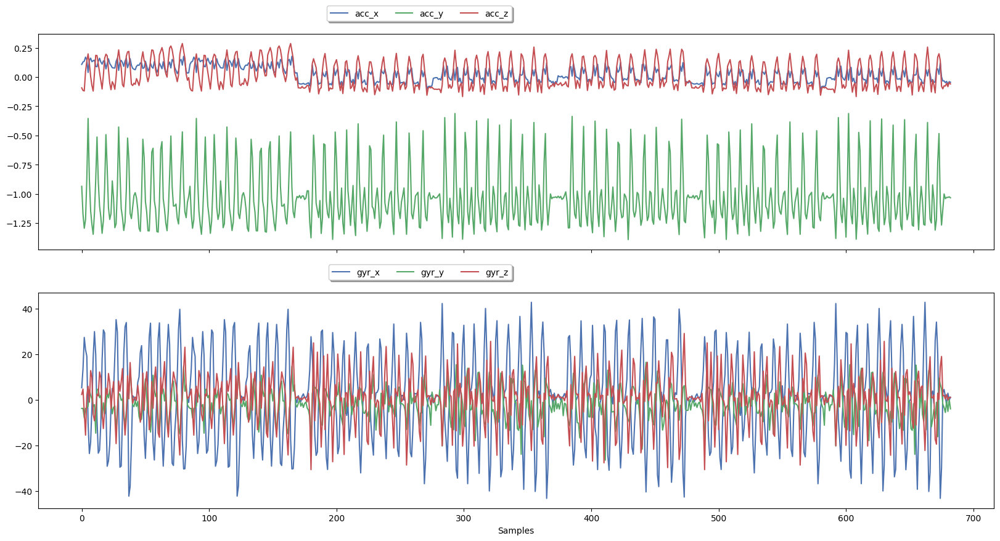

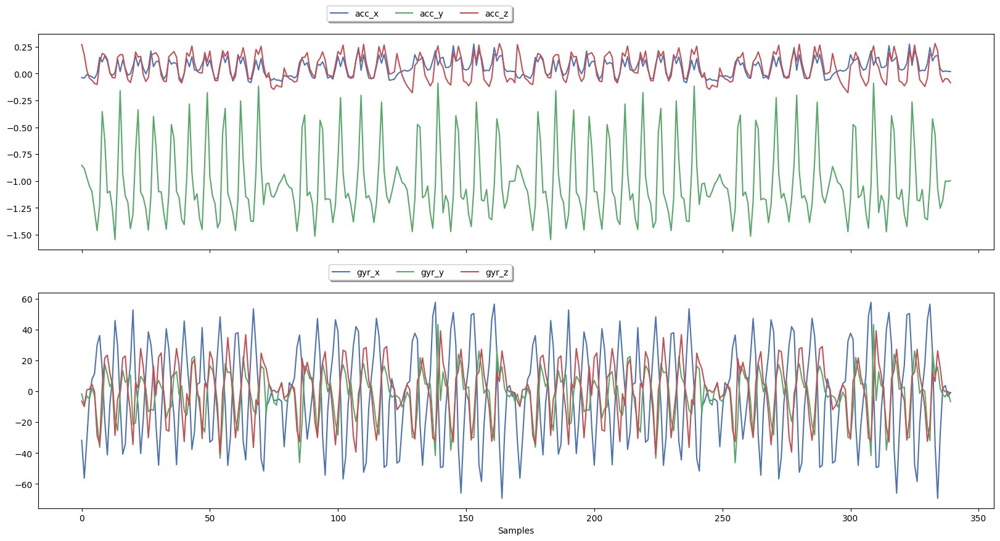

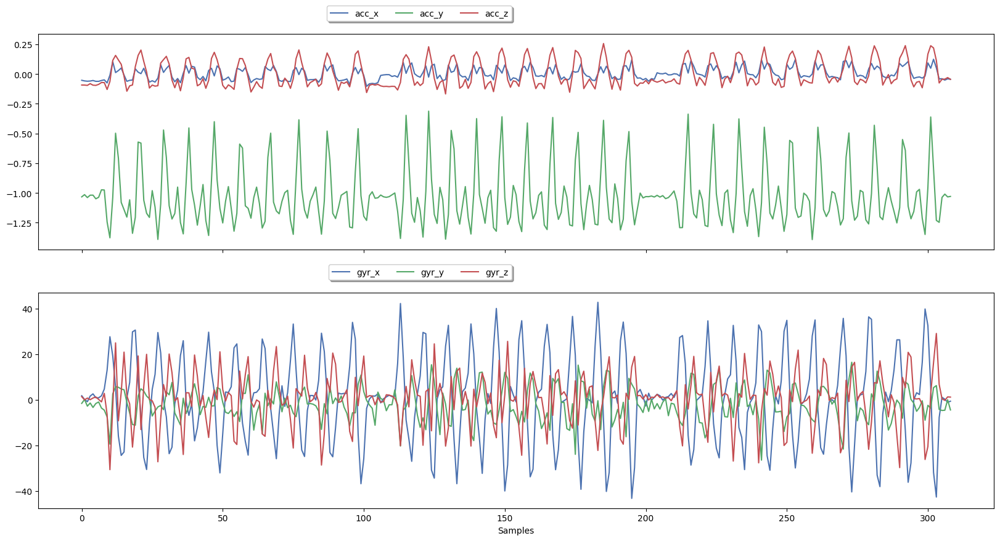

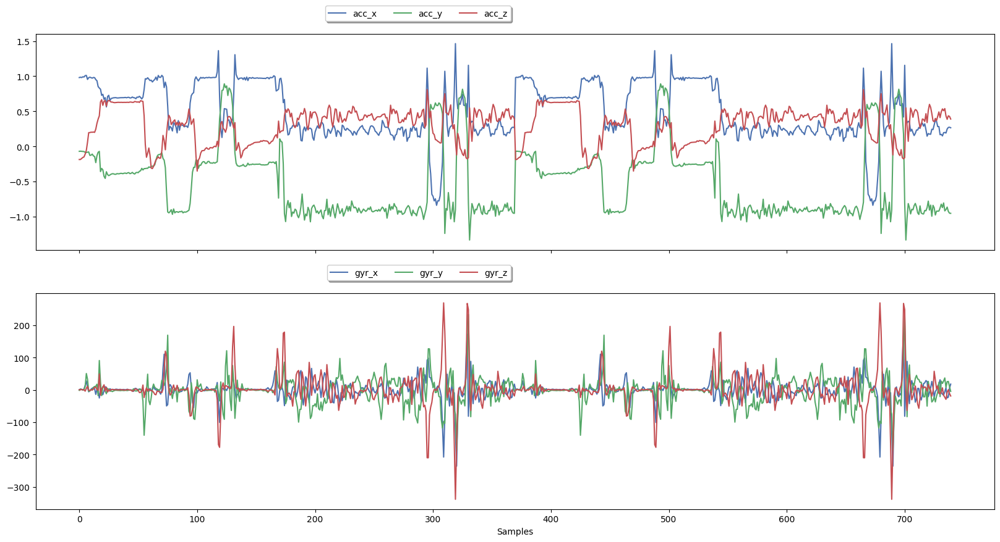

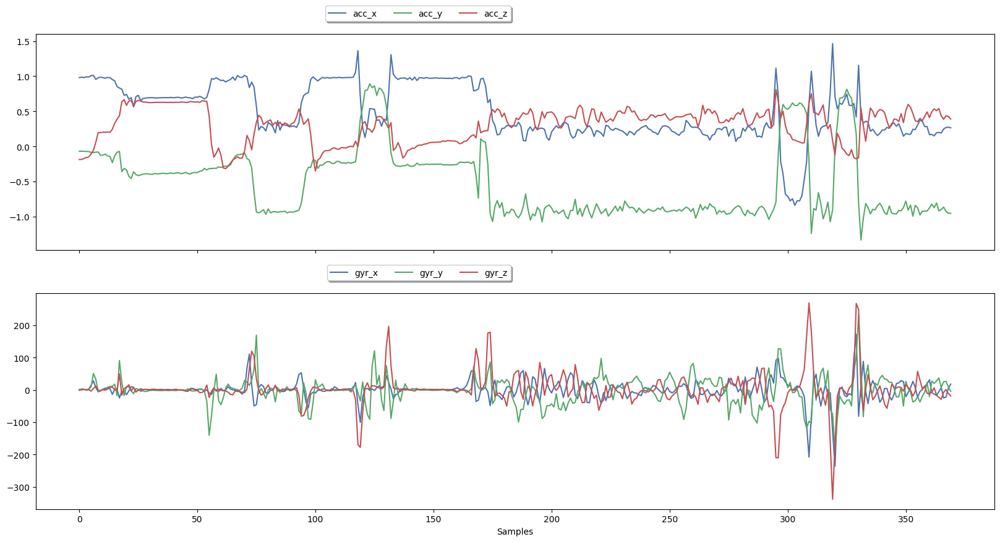

In [20]:
labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        combined_plot_df = (
            df.query(f"label == '{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )

        if len(combined_plot_df) > 0:
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

            ax[0].legend(
                loc="upper right",
                bbox_to_anchor=(0.5, 1.15),
                ncol=3,
                fancybox=True,
                shadow=True,
            )
            ax[1].legend(
                loc="upper right",
                bbox_to_anchor=(0.5, 1.15),
                ncol=3,
                fancybox=True,
                shadow=True,
            )
            ax[1].set_xlabel("Samples")

            plt.savefig(f"../../reports/figures/{label.title()}({participant}).png")
            plt.show()

Text(0.5, 0, 'Samples')

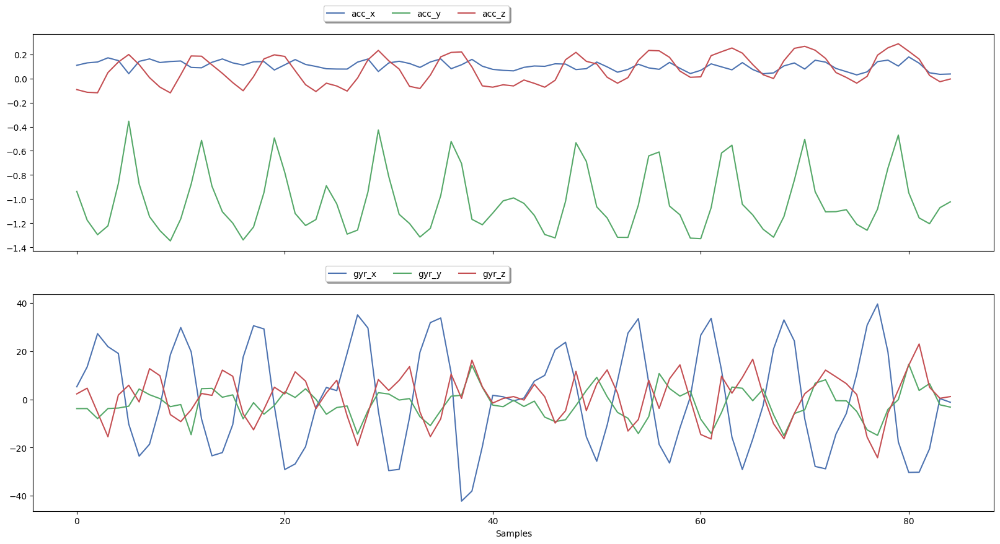

In [21]:
label = "row"
participant = " A"
combined_plot_df = (
    df.query(f"label == '{label}'").query(f"participant=='{participant}'").reset_index()
)

fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

ax[0].legend(
    loc="upper right", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
)
ax[1].legend(
    loc="upper right", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
)
ax[1].set_xlabel("Samples")

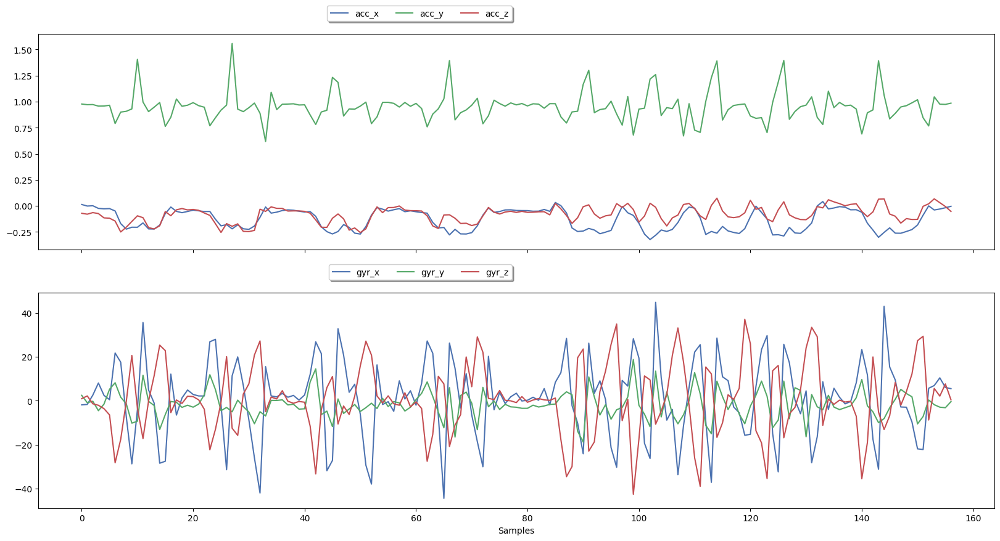

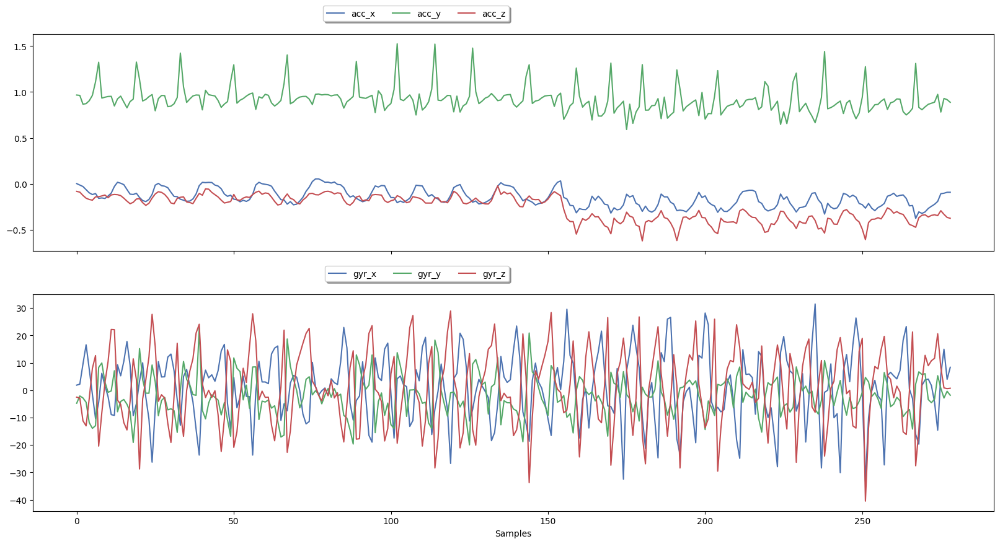

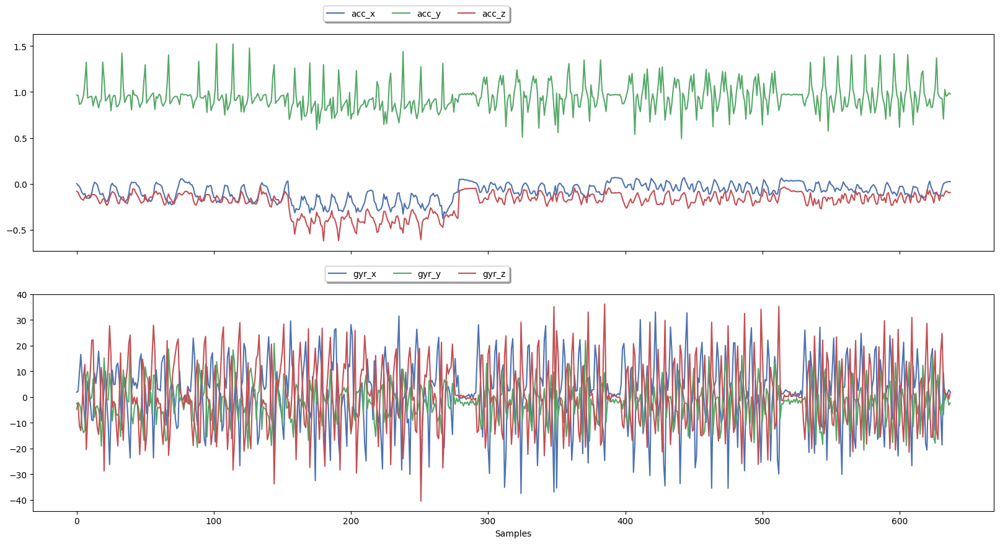

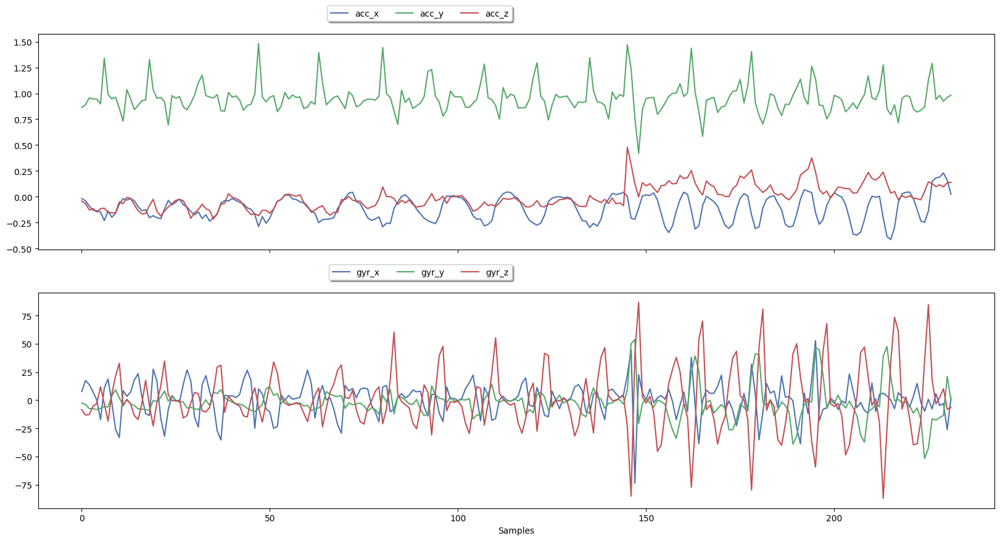

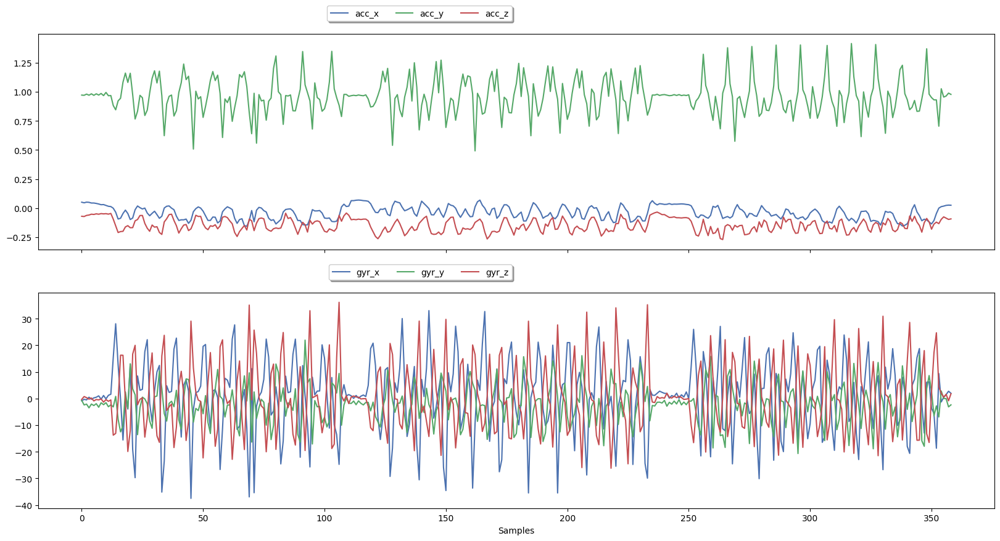

...

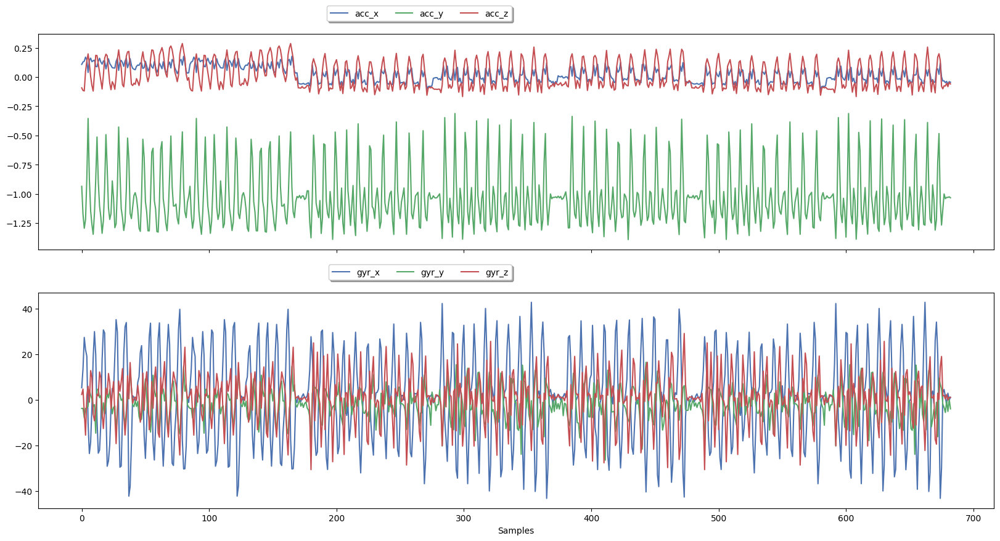

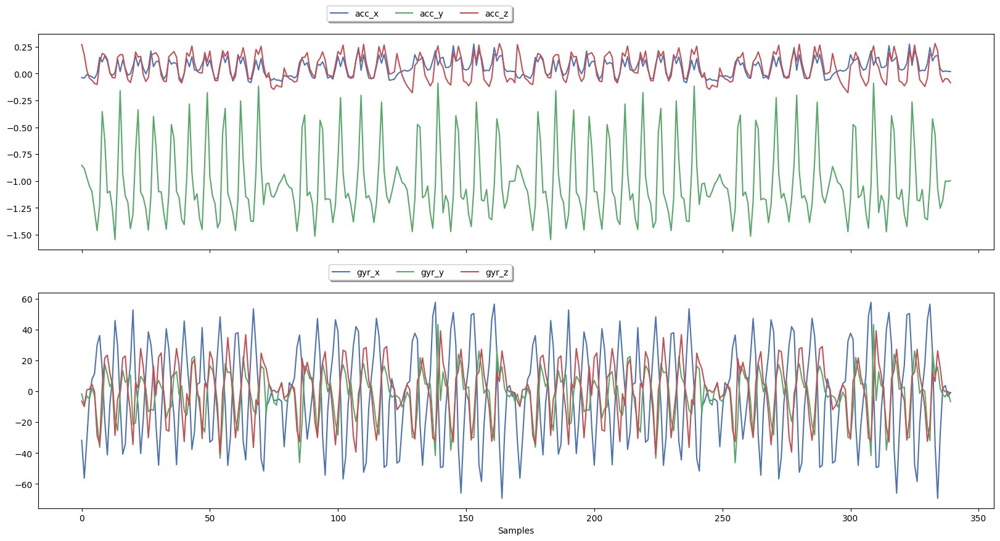

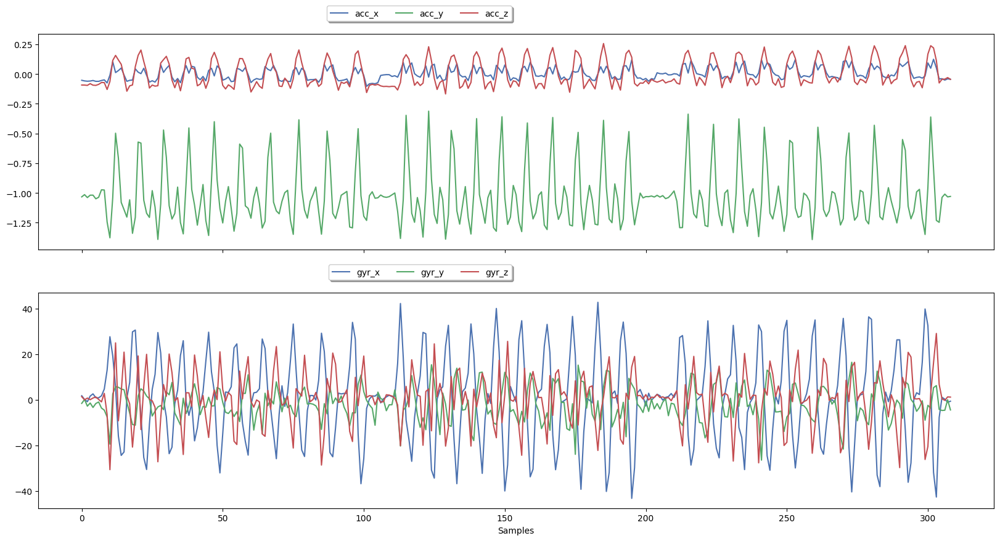

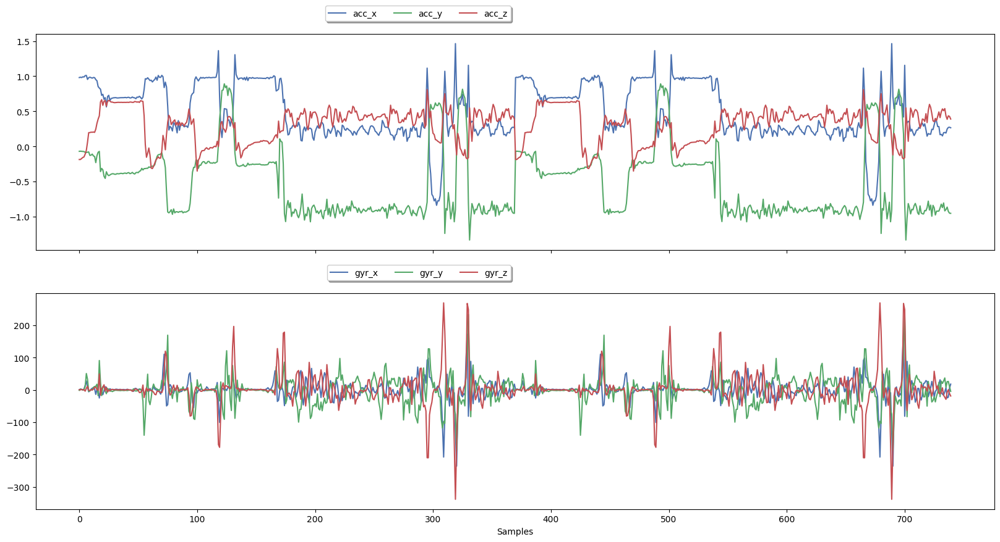

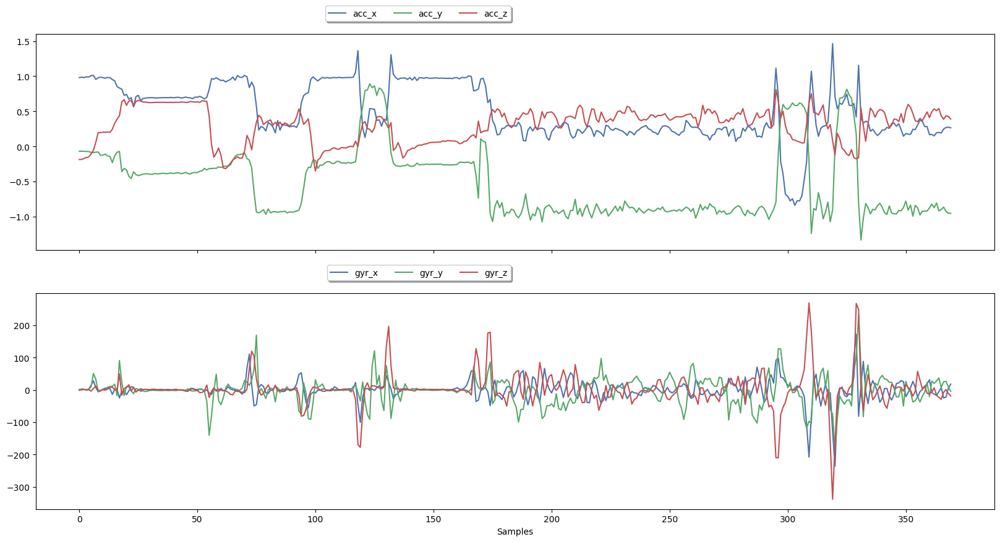

In [22]:
labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        combined_plot_df = (
            df.query(f"label == '{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )

        if len(combined_plot_df) > 0:
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            combined_plot_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            combined_plot_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

            ax[0].legend(
                loc="upper right",
                bbox_to_anchor=(0.5, 1.15),
                ncol=3,
                fancybox=True,
                shadow=True,
            )
            ax[1].legend(
                loc="upper right",
                bbox_to_anchor=(0.5, 1.15),
                ncol=3,
                fancybox=True,
                shadow=True,
            )
            ax[1].set_xlabel("Samples")

            plt.savefig(f"../../reports/figures/{label.title()}({participant}).png")
            plt.show()